# **Overview of the project**
This notebook is written by Jesse van der Ende, for the Spark course at ENSAI. The objective is to load, process and model the gas prices in France in the periode 2022-2024. Below is a short overview of the project.

0. Imports and setting up PySpark
1. Collect the data
2. Prepare the data
3. Visualize the data
4. Model the data

## **0. Imports and setting up PySpark**

In [1]:
import os
import requests
import yaml
import pyspark
import pyspark.sql.functions as F
from pyspark.sql.types import StructType, StructField, IntegerType, StringType, DoubleType, DateType
import seaborn as sns
import matplotlib.pyplot as plt
import folium
import geopandas as gpd
import pandas as pd

from pyspark.ml import Pipeline
from pyspark.ml.feature import VectorAssembler, StringIndexer, OneHotEncoder
from pyspark.ml.regression import LinearRegression
from pyspark.ml.regression import RandomForestRegressor
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.sql.window import Window


In [2]:
os.environ['JAVA_HOME'] = '/usr/lib/jvm/java-1.17.0-openjdk-amd64'

spark = pyspark.sql.SparkSession.builder \
    .appName('PySparkProject') \
    .config("spark.driver.memory", "8g") \
    .config("spark.executor.memory", "8g") \
    .getOrCreate()

# Suppress Spark warnings
spark.sparkContext.setLogLevel("ERROR")
print(f"Spark version: {spark.version}")

Using Spark's default log4j profile: org/apache/spark/log4j2-defaults.properties
Setting default log level to "WARN".
To adjust logging level use sc.setLogLevel(newLevel). For SparkR, use setLogLevel(newLevel).
26/01/14 03:56:05 WARN NativeCodeLoader: Unable to load native-hadoop library for your platform... using builtin-java classes where applicable


Spark version: 4.1.0


## **1. Data Collection**

This section downloads the gas data from 2022 - 2024. It proceeds in the following way.

* Define a function that fetches all available files on the GitHub.
* Define a function that downloads the right files from the GitHub.
* Define a function that creates the YAML file to save the config.
* Create the YAML configuration file.
* Download the gasprice files from 2022 - 2024, as wel ass the services and stations files from 2024.

In [3]:
def get_available_files(github_url):
    """
    Fetch list of available files from GitHub repository using GitHub API
    
    Parameters:
    - github_url: GitHub repository URL (e.g., https://github.com/owner/repo)
    
    Returns:
    - List of filenames available in the repository
    """
    # Convert GitHub URL to API URL
    # From: https://github.com/rvm-courses/GasPrices
    # To: https://api.github.com/repos/rvm-courses/GasPrices/contents
    parts = github_url.replace('https://github.com/', '').strip('/')
    api_url = f"https://api.github.com/repos/{parts}/contents"
    
    try:
        print(f"Fetching available files from {github_url}")
        response = requests.get(api_url)
        response.raise_for_status()
        
        files = response.json()
        csv_files = [f['name'] for f in files if f['name'].endswith('.csv.gz')]
        
        print(f"Found {len(csv_files)} CSV files.")
        
        return csv_files
    except Exception as e:
        print(f"Error fetching file list: {e}")
        return []
    
def setup_directories(config):
    """Create all necessary directories from config"""
    directories = [
        config['data_directory'],
        config['plot_directory'],
        config['map_directory']
    ]
    
    for directory in directories:
        if not os.path.exists(directory):
            os.makedirs(directory)

def download_from_github(data_directory, github_url, first_year, last_year, stations_services_year, **kwargs):
    """
    Download gas price files from GitHub repository.
    First checks which files are available, then downloads matching files.
    
    Parameters:
    - data_directory: path where files will be saved
    - github_url: GitHub repository URL
    - first_year: starting year for data download
    - last_year: ending year for data download
    - stations_services_year: year for GasStations and Services files
    - **kwargs: additional config parameters (ignored)
    """
    # Get list of available files from GitHub
    available_files = get_available_files(github_url)
    
    # Determine which files to download based on year range
    files_to_download = []
    
    # Add gas price files for each year
    for year in range(first_year, last_year + 1):
        # Look for files matching the year pattern
        year_files = [f for f in available_files if f"Prix{year}" in f]
        files_to_download.extend(year_files)
    
    # Add station and services files (specified year)
    station_and_services_files = [f for f in available_files if f"Stations{stations_services_year}" in f or f"Services{stations_services_year}" in f]
    files_to_download.extend(station_and_services_files)
    
    # Download files
    print(f"\nWill download {len(files_to_download)} files.")
    downloaded_files = []
    
    # Convert to raw GitHub URL
    raw_base_url = github_url.replace('github.com', 'raw.githubusercontent.com') + '/master'
    
    for file in files_to_download:
        file_url = f"{raw_base_url}/{file}"
        file_path = os.path.join(data_directory, file)
        
        try:
            print(f"  Downloading {file}...", end=" ")
            response = requests.get(file_url)
            response.raise_for_status()
            
            with open(file_path, 'wb') as f:
                f.write(response.content)
            
            file_size = os.path.getsize(file_path) / (1024 * 1024)
            print(f"({file_size:.2f} MB)")
            downloaded_files.append(file)
        except Exception as e:
            print(f"Error: {e}")
    
    print("\nDownload complete!")
    return downloaded_files

def create_yaml_config(file_path='config.yaml', 
                       data_directory='./gas_data', 
                       github_url='https://github.com/rvm-courses/GasPrices',
                       first_year=2022,
                       last_year=2024,
                       stations_services_year=2024,
                       plot_directory='./plots',
                       map_directory='./maps'):
    """Create a YAML configuration file with parameters"""
    config = {
        'data_directory': data_directory,
        'github_url': github_url,
        'first_year': first_year,
        'last_year': last_year,
        'stations_services_year': stations_services_year,
        'plot_directory': plot_directory,
        'map_directory': map_directory
    }
    
    with open(file_path, 'w') as file:
        yaml.dump(config, file, default_flow_style=False)
    
    return config

def load_config(config_path='config.yaml'):
    """Load configuration from YAML file"""
    with open(config_path, 'r') as file:
        return yaml.safe_load(file)

# Create configuration file
config = create_yaml_config(
    file_path='gas_prices_config.yaml',
    data_directory='./gas_price_data',
    github_url='https://github.com/rvm-courses/GasPrices',
    first_year=2022,
    last_year=2024,
    stations_services_year=2024,
    plot_directory='./plots',
    map_directory='./maps'
)

print("\nConfiguration:")
for key, value in config.items():
    print(f"  {key}: {value}")


Configuration:
  data_directory: ./gas_price_data
  github_url: https://github.com/rvm-courses/GasPrices
  first_year: 2022
  last_year: 2024
  stations_services_year: 2024
  plot_directory: ./plots
  map_directory: ./maps


In [4]:
# Load configuration and set up directories
config = load_config('gas_prices_config.yaml')
setup_directories(config)

In [5]:
# Download files from GitHub using the configuration
downloaded_files = download_from_github(**config)

print(f"\nTotal files downloaded: {len(downloaded_files)}")
print(f"Files saved to: {config['data_directory']}")


Fetching available files from https://github.com/rvm-courses/GasPrices
Found 37 CSV files.

Will download 6 files.

Download complete!

Total files downloaded: 6
Files saved to: ./gas_price_data


## **2. Data preprocessing**

### 2.1 Load all gas files into one dataframe

I start by defining the schema, loading all the gas price files into one dataframe and provide a quick viewover of the data.

In [6]:
# Read all gas price CSV files
data_dir = config['data_directory']

# Define schema explicitly
prices_schema = StructType([
    StructField("id_pdv", IntegerType(), True),
    StructField("cp", StringType(), True),  # String to preserve leading zeros
    StructField("pop", StringType(), True),
    StructField("latitude", DoubleType(), True),
    StructField("longitude", DoubleType(), True),
    StructField("date", DateType(), True),
    StructField("id_carburant", IntegerType(), True),
    StructField("nom_carburant", StringType(), True),
    StructField("prix", DoubleType(), True)
])

# Read the gas price files with explicit schema
df_gas = spark.read.csv(f"{data_dir}/Prix*", header=False, schema=prices_schema, sep=';')

print(f"Total records: {df_gas.count():,}")
print(f"\nSchema:")
df_gas.printSchema()
print(f"\nFirst few rows:")
df_gas.show(5)

Total records: 14,214,837

Schema:
root
 |-- id_pdv: integer (nullable = true)
 |-- cp: string (nullable = true)
 |-- pop: string (nullable = true)
 |-- latitude: double (nullable = true)
 |-- longitude: double (nullable = true)
 |-- date: date (nullable = true)
 |-- id_carburant: integer (nullable = true)
 |-- nom_carburant: string (nullable = true)
 |-- prix: double (nullable = true)


First few rows:
+-------+-----+---+---------+---------+----------+------------+-------------+-----+
| id_pdv|   cp|pop| latitude|longitude|      date|id_carburant|nom_carburant| prix|
+-------+-----+---+---------+---------+----------+------------+-------------+-----+
|1000001|01000|  R|4620100.0| 519800.0|2023-01-02|           1|       Gazole|1.867|
|1000001|01000|  R|4620100.0| 519800.0|2023-01-05|           1|       Gazole|1.877|
|1000001|01000|  R|4620100.0| 519800.0|2023-01-09|           1|       Gazole|1.875|
|1000001|01000|  R|4620100.0| 519800.0|2023-01-11|           1|       Gazole|1.859|
|1000

Additionally, I load the stations and services file into a dataframe.

In [7]:
# Define schema explicitly
stations_schema = StructType([
    StructField("id_pdv", IntegerType(), True),
    StructField("cp", StringType(), True),  # String to preserve leading zeros
    StructField("pop", StringType(), True),
    StructField("latitude", DoubleType(), True),
    StructField("longitude", DoubleType(), True),
    StructField("adresse", StringType(), True),
    StructField("ville", StringType(), True)
])

# Load the stations file
stations_df = spark.read.csv(f"{data_dir}/Stations2024.csv.gz", sep='|', schema=stations_schema)

print("Stations file schema:")
stations_df.printSchema()

print("First few rows of stations:")
stations_df.show(5)

Stations file schema:
root
 |-- id_pdv: integer (nullable = true)
 |-- cp: string (nullable = true)
 |-- pop: string (nullable = true)
 |-- latitude: double (nullable = true)
 |-- longitude: double (nullable = true)
 |-- adresse: string (nullable = true)
 |-- ville: string (nullable = true)

First few rows of stations:
+-------+-----+---+-------------+-------------+--------------------+--------------------+
| id_pdv|   cp|pop|     latitude|    longitude|             adresse|               ville|
+-------+-----+---+-------------+-------------+--------------------+--------------------+
|1000001|01000|  R|    4620100.0|     519800.0|596 AVENUE DE TRE...|SAINT-DENIS-LèS-B...|
|1000002|01000|  R|    4621842.0|     522767.0| 16 Avenue de Marboz|     BOURG-EN-BRESSE|
|1000004|01000|  R|    4618800.0|     524500.0|20 Avenue du Maré...|     Bourg-en-Bresse|
|1000005|01000|  R|4620093.59235|519942.024022|642 Avenue de Tré...|SAINT-DENIS-LèS-B...|
|1000006|01000|  R|    4620754.0|     523758.0|1 

In [8]:
# Define schema explicitly
services_schema = StructType([
    StructField("id_pdv", IntegerType(), True),
    StructField("cp", StringType(), True),  # String to preserve leading zeros
    StructField("pop", StringType(), True),
    StructField("latitude", DoubleType(), True),
    StructField("longitude", DoubleType(), True),
    StructField("services", StringType(), True)
])

# Load the services file
services_df = spark.read.csv(f"{data_dir}/Services2024.csv.gz", sep='|', schema=services_schema)

print("Services file schema:")
services_df.printSchema()

print("First few rows of services:")
services_df.show(5)

Services file schema:
root
 |-- id_pdv: integer (nullable = true)
 |-- cp: string (nullable = true)
 |-- pop: string (nullable = true)
 |-- latitude: double (nullable = true)
 |-- longitude: double (nullable = true)
 |-- services: string (nullable = true)

First few rows of services:
+-------+-----+---+-------------+-------------+--------------------+
| id_pdv|   cp|pop|     latitude|    longitude|            services|
+-------+-----+---+-------------+-------------+--------------------+
|1000001|01000|  R|    4620100.0|     519800.0|Station de gonfla...|
|1000002|01000|  R|    4621842.0|     522767.0|Vente de gaz dome...|
|1000004|01000|  R|    4618800.0|     524500.0|Toilettes publiqu...|
|1000005|01000|  R|4620093.59235|519942.024022|Boutique alimenta...|
|1000006|01000|  R|    4620754.0|     523758.0|Vente de gaz dome...|
+-------+-----+---+-------------+-------------+--------------------+
only showing top 5 rows


### 2.2 Analyze missing values

I then analyze the missing values. We have 12756 missing values for the date, gas id, gas name and price, as well as 207 missing values for the latitude and 204 missing values for the longitude. As we have more than 14 million observations, I choose to remove all observations with missing values from the dataset. This removes a total of 12756 rows.

In [9]:
# Create a missing value summary DataFrame
missing_summary = df_gas.select([
    F.count("*").alias("total_rows"),
    *[F.count(F.when(F.col(c).isNull(), c)).alias(f"null_{c}") for c in df_gas.columns]
])
missing_summary.show()

# Remove the missing values from the dataset
df_gas_no_missing = df_gas.na.drop()

print(f"Records removed: {df_gas.count() - df_gas_no_missing.count():,}")
print(f"Records after removing NULL gas types: {df_gas_no_missing.count():,}")

+----------+-----------+-------+--------+-------------+--------------+---------+-----------------+------------------+---------+
|total_rows|null_id_pdv|null_cp|null_pop|null_latitude|null_longitude|null_date|null_id_carburant|null_nom_carburant|null_prix|
+----------+-----------+-------+--------+-------------+--------------+---------+-----------------+------------------+---------+
|  14214837|          0|      0|       0|          207|           204|    12756|            12756|             12756|    12756|
+----------+-----------+-------+--------+-------------+--------------+---------+-----------------+------------------+---------+



Records removed: 12,756


Records after removing NULL gas types: 14,202,081


### 2.3 Transform variables and register table for SQL queries

I transform the data by adding year, month, and week columns, scaling latitude/longitude coordinates, and registering as a SQL table.

The week column is calculated as `ceil(day_of_year / 7)`, which naturally produces weeks 1-53 since years have 365+ days. To maintain consistency across all years, observations from week 53 are merged into week 52, ensuring exactly 52 weeks per year. This provides a clean 156-week index for the three-year period (2022-2024).

In [10]:
# Convert date to proper date format and extract year, month, day, week
df_gas_transformed = df_gas_no_missing.withColumn("year", F.year("date")) \
    .withColumn("month", F.month("date")) \
    .withColumn("day", F.dayofmonth("date")) \
    .withColumn("week", F.ceil(F.dayofyear("date") / 7))

# Merge values for week 53 into week 52
df_gas_transformed = df_gas_transformed.withColumn("week", F.when(F.col("week") > 52, 52).otherwise(F.col("week")))

# Fix latitude and longitude (divide by 100000 to get proper coordinates)
df_gas_transformed = df_gas_transformed.withColumn("latitude", F.col("latitude") / 100000.0) \
    .withColumn("longitude", F.col("longitude") / 100000.0)

# Register for SQL queries
df_gas_transformed.createOrReplaceTempView("gas_prices")

print(f"\nSample of transformed data:")
df_gas_transformed.select("date", "year", "month", "week", "day", "latitude", "longitude").show(15)


Sample of transformed data:
+----------+----+-----+----+---+--------+---------+
|      date|year|month|week|day|latitude|longitude|
+----------+----+-----+----+---+--------+---------+
|2023-01-02|2023|    1|   1|  2|  46.201|    5.198|
|2023-01-05|2023|    1|   1|  5|  46.201|    5.198|
|2023-01-09|2023|    1|   2|  9|  46.201|    5.198|
|2023-01-11|2023|    1|   2| 11|  46.201|    5.198|
|2023-01-13|2023|    1|   2| 13|  46.201|    5.198|
|2023-01-16|2023|    1|   3| 16|  46.201|    5.198|
|2023-01-17|2023|    1|   3| 17|  46.201|    5.198|
|2023-01-19|2023|    1|   3| 19|  46.201|    5.198|
|2023-01-23|2023|    1|   4| 23|  46.201|    5.198|
|2023-05-09|2023|    5|  19|  9|  46.201|    5.198|
|2023-05-12|2023|    5|  19| 12|  46.201|    5.198|
|2023-05-15|2023|    5|  20| 15|  46.201|    5.198|
|2023-05-16|2023|    5|  20| 16|  46.201|    5.198|
|2023-05-19|2023|    5|  20| 19|  46.201|    5.198|
|2023-05-22|2023|    5|  21| 22|  46.201|    5.198|
+----------+----+-----+----+---+---

### 2.4 Analyze which gas types to filter out

I then analyze the statistics to determine which two gas types to filter out. Based on the statistics below, I see that the two gastypes E85 and GPLc have the lowest mean price. In particulair, E85 also has considerably lower number of observations and standard deviation than the other gastypes.

In [11]:
# 1. Comprehensive statistics by gas type
print("Detailed Statistics by Gas Type:")

gas_analysis = spark.sql("""
    SELECT 
        id_carburant,
        nom_carburant,
        COUNT(*) as record_count,
        COUNT(DISTINCT id_pdv) as station_count,
        MIN(prix) as min_price,
        PERCENTILE_APPROX(prix, 0.25) as Q1,
        AVG(prix) as avg_price,
        PERCENTILE_APPROX(prix, 0.75) as Q3,
        MAX(prix) as max_price,
        STDDEV(prix) as stddev_price
    FROM gas_prices
    GROUP BY id_carburant, nom_carburant
    ORDER BY record_count DESC
""")

gas_analysis.show(20, truncate=False)

# 2. Standard Deviation by Gas Type and Year

stddev_by_year = spark.sql("""
    SELECT 
        year,
        nom_carburant,
        STDDEV(prix) as stddev_price
    FROM gas_prices
    GROUP BY year, nom_carburant
    ORDER BY year, nom_carburant
""")


# Pivot view for standard deviation
stddev_pivot = stddev_by_year.groupBy("year").pivot("nom_carburant").agg(
    F.first("stddev_price")
).orderBy("year")

print("Standard Deviation by Year and Gas Type:")
stddev_pivot.show(truncate=False)


Detailed Statistics by Gas Type:


+------------+-------------+------------+-------------+---------+-----+------------------+-----+---------+-------------------+
|id_carburant|nom_carburant|record_count|station_count|min_price|Q1   |avg_price         |Q3   |max_price|stddev_price       |
+------------+-------------+------------+-------------+---------+-----+------------------+-----+---------+-------------------+
|1           |Gazole       |4245380     |10391        |0.001    |1.699|1.8076891830648851|1.899|9.999    |0.15007426030069446|
|5           |E10          |3559498     |8256         |0.001    |1.737|1.8212468297495883|1.905|9.999    |0.14172403196096608|
|6           |SP98         |3425844     |8873         |0.001    |1.829|1.9146087253243298|1.99 |9.999    |0.14281531704473488|
|3           |E85          |1390580     |4067         |0.001    |0.804|0.9214198967337379|0.999|9.989    |0.1475646795428594 |
|2           |SP95         |961020      |5049         |0.004    |1.771|1.84873648935506  |1.927|9.999    |0.131

Standard Deviation by Year and Gas Type:


+----+-------------------+-------------------+-------------------+-------------------+-------------------+-------------------+
|year|E10                |E85                |GPLc               |Gazole             |SP95               |SP98               |
+----+-------------------+-------------------+-------------------+-------------------+-------------------+-------------------+
|2022|0.1898018505889543 |0.09594148645628496|0.1060661947825562 |0.1703481195078234 |0.1790508245659535 |0.19316421873152992|
|2023|0.09623412446253014|0.09847272014029573|0.08919564327232848|0.11776647388425457|0.08339831089302902|0.1012380547083227 |
|2024|0.10164298725434275|0.0791305159639289 |0.08008732524919604|0.10272812427244711|0.08211228068470741|0.0997394120766724 |
+----+-------------------+-------------------+-------------------+-------------------+-------------------+-------------------+



### 2.5 Construct price and week index

I now construct the price and week index. For the price, I first calculate the average day price for each fuel type across France and then divde the gasprice by this average.

In [12]:
# Step 1: Calculate national average per day per gas type
national_avg = df_gas_transformed.groupBy("date", "nom_carburant").agg(F.avg("prix").alias("avg_national_price"))

# Step 2: Join on calendar day and gas type
df_with_avg = df_gas_transformed.join(national_avg, ["date", "nom_carburant"])

# Step 3: Calculate price index
df_with_index = df_with_avg.withColumn("price_index", (F.col("prix") / F.col("avg_national_price")) * 100)

df_with_index.sort("date", "nom_carburant").show(10)

+----------+-------------+-------+-----+---+------------------+------------------+------------+-----+----+-----+---+----+------------------+------------------+
|      date|nom_carburant| id_pdv|   cp|pop|          latitude|         longitude|id_carburant| prix|year|month|day|week|avg_national_price|       price_index|
+----------+-------------+-------+-----+---+------------------+------------------+------------+-----+----+-----+---+----+------------------+------------------+
|2022-01-01|          E10|1000012|01000|  R|            46.201|               5.2|           5|1.714|2022|    1|  1|   1|1.6803428869202677|102.00299077894863|
|2022-01-01|          E10|1430005|01430|  A|           46.1237|           5.49956|           5|1.809|2022|    1|  1|   1|1.6803428869202677|107.65659878594987|
|2022-01-01|          E10|1000013|01000|  R|     46.1985183794| 5.243506378809999|           5|1.609|2022|    1|  1|   1|1.6803428869202677| 95.75426613963148|
|2022-01-01|          E10|1120008|01120|

I then construct a week index using the year and week columns. The formula is: week_index = (year - 2022) * 52 + week. This ensures that week 52 of 2022 has index 52, week 52 of 2023 has index 104 (52+52), and week 52 of 2024 has index 156 (104+52).

In [13]:
# Get the minimum year from the data to use as the base year
min_year = df_with_index.agg(F.min("year")).collect()[0][0]

# Add a column showing the week index based on year and week columns
df_preprocessed = df_with_index.withColumn("week_index", ((F.col("year") - min_year) * 52 + F.col("week")).cast("integer"))

# Display sample with week_index
df_preprocessed.select("date", "year", "week", "week_index", "nom_carburant", "price_index").show(10)

+----------+----+----+----------+-------------+------------------+
|      date|year|week|week_index|nom_carburant|       price_index|
+----------+----+----+----------+-------------+------------------+
|2023-07-04|2023|  27|        79|         SP98| 95.23133056924532|
|2023-07-20|2023|  29|        81|         SP98|  94.1990116891442|
|2023-07-04|2023|  27|        79|         SP98| 99.00286841357186|
|2023-07-20|2023|  29|        81|         SP98|  97.8577260381208|
|2023-07-30|2023|  31|        83|          E85| 94.63773350871256|
|2023-10-18|2023|  42|        94|          E85| 97.47907763955368|
|2023-07-04|2023|  27|        79|         SP98|104.24111541958095|
|2023-07-20|2023|  29|        81|         SP98|102.54706414737251|
|2023-07-30|2023|  31|        83|          E85| 94.63773350871256|
|2023-10-18|2023|  42|        94|          E85| 97.47907763955368|
+----------+----+----+----------+-------------+------------------+
only showing top 10 rows


## **3. Data Visualization**

I begin by calculating the average gas price in a week for each of the gas types.

In [14]:
# Group by gastype and week index and take the average of the price, then convert to pandas dataframe for plotting
pandas_df = df_preprocessed.groupBy("nom_carburant", "week_index").agg(F.avg("prix").alias("avg_prix")).toPandas()
pandas_df.head(10)

,nom_carburant,week_index,avg_prix
0,SP98,78,1.907635
1,E85,75,1.104907
2,GPLc,71,0.998791
3,Gazole,71,1.673606
4,E85,79,1.040611
5,SP98,54,1.939784
6,E85,94,1.027459
7,E85,60,1.140468
8,GPLc,75,0.996621
9,SP95,82,1.888112


While the assignment suggested using FacetGrid to create separate subplots for each gas type, I chose to display all gas types on a single plot instead. This approach allows for direct visual comparison of price trends across different fuel types, making it easier to identify:

- Which fuels are most expensive over time
- How price movements correlate between different fuel types

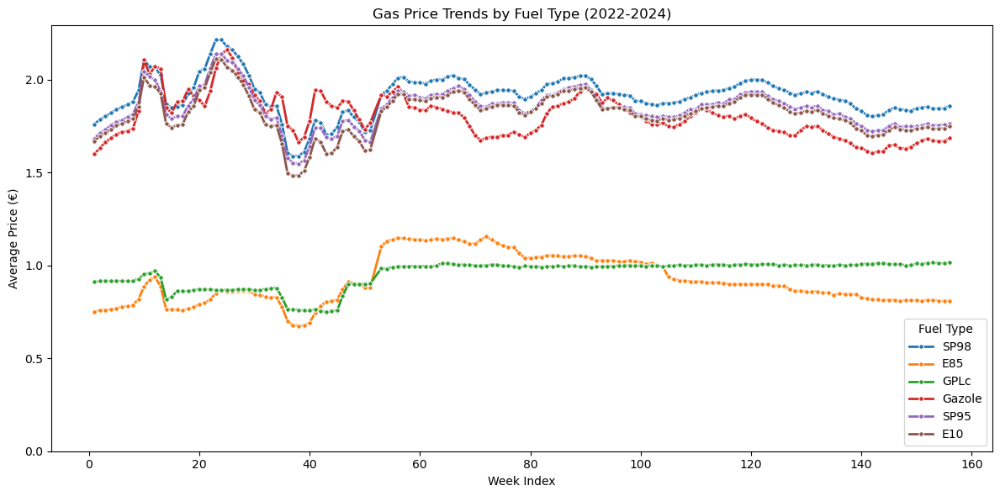

In [15]:
# Plot all gas types on a single plot for better comparison
plt.figure(figsize=(12, 6))
sns.lineplot(data=pandas_df, x="week_index", y="avg_prix", hue="nom_carburant", marker="o", markersize=4, linewidth=2)
plt.xlabel("Week Index")
plt.ylabel("Average Price (€)")
plt.title("Gas Price Trends by Fuel Type (2022-2024)")
plt.ylim(bottom=0)
plt.legend(title="Fuel Type", loc='lower right')

plt.tight_layout()
plt.savefig(f"{config['plot_directory']}/gas_price_trends.png", dpi=300, bbox_inches='tight')
plt.show()


In the above results we can observe that the GPLc and E85 gas types behave very differently from the other four. They have less variation over time, have a lower price and do not co-move together as the other three. We also see that in 2022 there was large variation in the gas price in general, while in the last two years the variation was less.

I now construct maps to visualize the geographical differences of the gas prices.

In [16]:
# Download French department boundaries (same source as the reference notebook for plotting with geopandas)
departments_url = "https://raw.githubusercontent.com/gregoiredavid/france-geojson/master/departements.geojson"

# Load the department boundaries
departments = gpd.read_file(departments_url)
print(departments.head())

# Extract department code from postal code (first 2 digits)
# Handle Corsica special case: split 2A (20000-20199) and 2B (20200-20999)
df_with_dept = df_preprocessed.withColumn(
    "dept_code", 
    F.when(F.col("cp").between("20000", "20199"), "2A")
     .when(F.col("cp").between("20200", "20999"), "2B")
     .otherwise(F.col("cp").substr(1, 2))
)

# Aggregate gas prices by department and fuel type
dept_prices = df_with_dept.groupBy("dept_code", "nom_carburant").agg(
    F.avg("prix").alias("avg_price")
).toPandas()

print("\nDepartment price summary:")
print(dept_prices.head(10))

  code                      nom  \
0   01                      Ain   
1   02                    Aisne   
2   03                   Allier   
3   04  Alpes-de-Haute-Provence   
4   05             Hautes-Alpes   

                                            geometry  
0  POLYGON ((4.78021 46.17668, 4.78024 46.18905, ...  
1  POLYGON ((3.17296 50.01131, 3.17382 50.01186, ...  
2  POLYGON ((3.03207 46.79491, 3.03424 46.7908, 3...  
3  POLYGON ((5.67604 44.19143, 5.67817 44.19051, ...  
4  POLYGON ((6.26057 45.12685, 6.26417 45.12641, ...  



Department price summary:
  dept_code nom_carburant  avg_price
0        26           E85   0.926394
1        22          GPLc   0.901005
2        37          SP95   1.839566
3        04          GPLc   0.937643
4        80          SP95   1.857721
5        74           E85   0.945079
6        38        Gazole   1.805228
7        51          SP95   1.851159
8        33        Gazole   1.786292
9        42           E85   0.937829


In [29]:
# Merge departments with geographic data (departments use 'code' column)
departments_with_prices = departments.merge(
    dept_prices, 
    left_on='code', 
    right_on='dept_code', 
    how='left'
)

for fuel_type in dept_prices['nom_carburant'].unique():
        
    # Create choropleth map with folium
    m = folium.Map(location=[46.5, 2.3], zoom_start=5, tiles='OpenStreetMap')

    # Add choropleth layer
    folium.Choropleth(
        geo_data=departments_with_prices,
        data=dept_prices.query('nom_carburant == @fuel_type'),
        columns=['dept_code', 'avg_price'],
        key_on='feature.properties.code',
        fill_color='YlOrRd',
        fill_opacity=0.7,
        line_opacity=0.2,
        legend_name=f'Average {fuel_type} Price (€/L)',
    ).add_to(m)

    m.save(f"{config['map_directory']}/map_{fuel_type}.html")

    # Display the map only for one gas type to prevent jupyter notebook to be too large to be uploaded in github
    # The map for other gas types can be found in the maps directory
    if fuel_type == dept_prices['nom_carburant'].unique()[1]:
        display(m)

The above results have confirmed that the GPLc and E85 gas prices are generally less interesting to analyze, as they have a lower standard deviation and correlate less with the other four gas types. Therefore I now filter them out, and they will not be considered for the rest of the application.

In [18]:
# Filter out specific gas types
excluded_gas_types = ["GPLc", "E85"]
filtered_prices_df = df_with_dept.filter(~df_with_dept["nom_carburant"].isin(excluded_gas_types))

# I cache the dataframe to avoid recomputation of the entire preprocessing steps
filtered_prices_df.cache()  
filtered_prices_df.describe().show()

+-------+-------------+--------------------+------------------+--------+------------------+------------------+------------------+-------------------+------------------+-----------------+------------------+------------------+-------------------+--------------------+-----------------+-----------------+
|summary|nom_carburant|              id_pdv|                cp|     pop|          latitude|         longitude|      id_carburant|               prix|              year|            month|               day|              week| avg_national_price|         price_index|       week_index|        dept_code|
+-------+-------------+--------------------+------------------+--------+------------------+------------------+------------------+-------------------+------------------+-----------------+------------------+------------------+-------------------+--------------------+-----------------+-----------------+
|  count|     12191742|            12191742|          12191742|12191742|          12191742|   

## **4. Modeling**

### 4.1 Feature Selection for Modeling

I start the modeling procedure by analyzing the current variables and data types in the dataframe to determine which one to include in the models. Below I printed the schema with the current variables available in my price dataset. They consist of the following:

* **date** : the date of the observation
* **nom_carburant** : the name of the gas type
* **id_pdv** : id of the gas station the gas is sold at
* **cp** : zip code of the gas station the gas is sold at
* **pop** : type of population (R: rural, A: urban, etc.)
* **latitude** : latitude of the gas station the gas is sold at
* **longitude** : longitude of the gas station the gas is sold at
* **id_carburant** : the id of the gas type
* **year** : year of the observation
* **month** : month of the observation
* **day** : day of the observation
* **week** : week of the year the observation was recorded in
* **avg_national_price** : the average national price at the same date as the observation
* **week index** : the index of the week the observation was recorded in, not relative to the year but in general
* **dept_code** : the code of the departement

In addition to these variables, we also have the variables of the Station and Services files which so far have not been used. While they contain overlapping variables such as the latitude, longitude and zip code, they do provide the following **additional** variables:

* **adresse** : the adress of the gas station
* **ville** : the city of the gas station
* **services** : a string of services list in natural language




In [19]:
filtered_prices_df.printSchema()
stations_df.printSchema()
services_df.printSchema()

root
 |-- date: date (nullable = true)
 |-- nom_carburant: string (nullable = true)
 |-- id_pdv: integer (nullable = true)
 |-- cp: string (nullable = true)
 |-- pop: string (nullable = true)
 |-- latitude: double (nullable = true)
 |-- longitude: double (nullable = true)
 |-- id_carburant: integer (nullable = true)
 |-- prix: double (nullable = true)
 |-- year: integer (nullable = true)
 |-- month: integer (nullable = true)
 |-- day: integer (nullable = true)
 |-- week: long (nullable = true)
 |-- avg_national_price: double (nullable = true)
 |-- price_index: double (nullable = true)
 |-- week_index: integer (nullable = true)
 |-- dept_code: string (nullable = true)

root
 |-- id_pdv: integer (nullable = true)
 |-- cp: string (nullable = true)
 |-- pop: string (nullable = true)
 |-- latitude: double (nullable = true)
 |-- longitude: double (nullable = true)
 |-- adresse: string (nullable = true)
 |-- ville: string (nullable = true)

root
 |-- id_pdv: integer (nullable = true)
 |-- cp:


To determine which variables I include I will nowhave to look at the models I will use. I will use both a linear regression and a random forest model to predict the prices. 

**Linear regression** works best when there's a straightforward, linear relationship between features and the target. This determines which variables make sense to include. I opt for a simple and interpretable model with a minimal amount of regressors, thereby preventing issues like multicollinearity.

**INCLUDE:**
- **week_index**: Gas prices tend to move smoothly over time due to for example inflation. This linear time trend captures that general direction.
- **year** (categorical): Some things change abruptly between years - new taxes get implemented, regulations change, unexpected events like COVID happen. Treating year as categorical lets each year have its own baseline rather than forcing a smooth trend.
- **nom_carburant** (categorical): Different fuels just cost different amounts. Using categorical encoding gives each fuel type its own baseline price.
- **pop** (categorical): Urban and rural stations tend to price differently due to competition and operating costs. This variable only has a few categories.
- **lag_station_fuel_price**: 1-lagged price of the fuel type at the specific station.

**EXCLUDE:**
- **date**: We already have week_index and year, which capture everything useful from date.
- **id_pdv**: Individual station IDs won't help us predict prices at new or different stations. We need patterns that generalize.
- **cp**: There are thousands of zip codes, which would create way too many dummy variables.
- **latitude/longitude**: The relationship between location and price isn't linear. Paris doesn't cost more than Lyon just because it's further north. Prices cluster around cities and refineries in complex ways that linear models can't capture well.
- **id_carburant**: This is just another way of encoding fuel type. We already have nom_carburant.
- **month**: Week_index handles the time trend better.
- **day**: Week_index handles the time trend better.
- **week**: Week_index handles the time trend better.
- **avg_national_price** (current day): We can't use this because it wouldn't be available when we're trying to predict. That's data leakage.
- **dept_code**: While different regions have different price levels due to transportation costs and local taxes, adding this variable to a regression means we add around a 100 onehot encoded variables. Therefore I opt not to include this variable for the linear regression.
- **adresse**: Too specific to be useful. Every station has a unique address.
- **ville**: France has thousands of cities, which would create thousands of dummy variables. This leads to overfitting and makes the model computationally expensive.
- **services**: This is text describing what amenities a station has (restrooms, car wash, etc.). Linear models can't handle raw text, and whether a station has a restroom probably doesn't affect gas prices anyway.

**Random forests** can handle non-linear relationships and high-cardinality categorical variables much better than linear regression. Also there is less concern of multicollinearty. Therefore I add back some features that didn't work for linear regression:

- **latitude/longitude**: Random forest can split on coordinates to discover geographic clusters. It figures out that prices are higher around cities or lower near refineries without assuming a linear relationship. The tree naturally learns these spatial patterns.
- **dept_code**: As Random forest can handle large number of regressors, I can now use the department code. However, both latitude and longitude contain information about the geographical location. The reason I use both is so that the random forest can create general splits early in the trees using the departments, and then go more granular using latitude and longitude.

Everything else excluded for linear regression (id_pdv, cp, services, date, etc.) remains excluded for the same reasons: they're either redundant or too specific to generalize.

### 4.2 Linear Regression

Below I fit my linear regression. I encode the categorical variables as one-hot encoding, as there is no natural order in any of these variables meaning only using the StringIndexer would not be correct. 

In [25]:
# Create lag for station-specific fuel price
window_spec_1d = Window.partitionBy("id_pdv", "nom_carburant").orderBy("date")
df_with_lag = filtered_prices_df.withColumn(
    "lag_station_fuel_price", 
    F.lag("prix", 1).over(window_spec_1d)
)

# Prepare data for linear regression
lr_modeling_df = df_with_lag.select(
    "prix",
    "week_index",
    "year",
    "nom_carburant",
    "pop", 
    "lag_station_fuel_price",
    "date"
).na.drop()

# Define all the stages for the pipeline
year_indexer = StringIndexer(inputCol="year", outputCol="year_index")
fuel_indexer = StringIndexer(inputCol="nom_carburant", outputCol="fuel_index")
pop_indexer = StringIndexer(inputCol="pop", outputCol="pop_index")

year_encoder = OneHotEncoder(inputCol="year_index", outputCol="year_vec")
fuel_encoder = OneHotEncoder(inputCol="fuel_index", outputCol="fuel_vec")
pop_encoder = OneHotEncoder(inputCol="pop_index", outputCol="pop_vec")

lr_feature_columns = ["week_index", "year_vec", "fuel_vec", "pop_vec", 
                     "lag_station_fuel_price"]
lr_assembler = VectorAssembler(inputCols=lr_feature_columns, outputCol="features")

lr = LinearRegression(featuresCol="features", labelCol="label", maxIter=10, regParam=0.01)

pipeline_stages = [
    year_indexer, fuel_indexer, pop_indexer,
    year_encoder, fuel_encoder, pop_encoder,
    lr_assembler,
    lr
]
pipeline = Pipeline(stages=pipeline_stages)

# Define label column and split data into training and test sets
lr_final_df = lr_modeling_df.withColumn("label", F.col("prix"))

# Take last 4 months as test set (approximately 10% of data)
cutoff_date = "2024-09-01"
train_df = lr_final_df.filter(F.col("date") < cutoff_date)
test_df = lr_final_df.filter(F.col("date") >= cutoff_date)

print(f"Training set size: {train_df.count():,}")
print(f"Test set size: {test_df.count():,}")

# Fit the pipeline model
pipeline_model = pipeline.fit(train_df)
lr_predictions = pipeline_model.transform(test_df)

# Evaluate the model
evaluator = RegressionEvaluator(labelCol="label", predictionCol="prediction")
lr_rmse = evaluator.setMetricName("rmse").evaluate(lr_predictions)
lr_r2 = evaluator.setMetricName("r2").evaluate(lr_predictions)
lr_mae = evaluator.setMetricName("mae").evaluate(lr_predictions)

# Get the linear regression model and summary
lr_model = pipeline_model.stages[-1]
summary = lr_model.summary

# Extract coefficient statistics
coefficients = lr_model.coefficients.toArray()
p_values = summary.pValues
t_values = summary.tValues
std_errors = summary.coefficientStandardErrors

# Get the indexers to understand feature names
year_indexer_model = pipeline_model.stages[0]
fuel_indexer_model = pipeline_model.stages[1]
pop_indexer_model = pipeline_model.stages[2]

year_labels = year_indexer_model.labels
fuel_labels = fuel_indexer_model.labels
pop_labels = pop_indexer_model.labels

# Build feature names list
feature_names = ["week_index"]
for year in year_labels[:-1]:
    feature_names.append(f"year_{year}")
for fuel in fuel_labels[:-1]:
    feature_names.append(f"fuel_{fuel}")
for pop in pop_labels[:-1]:
    feature_names.append(f"pop_{pop}")
feature_names.append("lag_station_fuel_price_1d")

# Display results
print("Coefficient Summary:")
print(f"{'Feature':<35} {'Coefficient':>12} {'Std_Error':>12} {'T_Value':>12} {'P_Value':>12} {'Sig':>5}")
print("-"*100)

for i, feat in enumerate(feature_names):
    sig = '***' if p_values[i] < 0.001 else '**' if p_values[i] < 0.01 else '*' if p_values[i] < 0.05 else ''
    print(f"{feat:<35} {coefficients[i]:12.6f} {std_errors[i]:12.6f} {t_values[i]:12.4f} {p_values[i]:12.6f} {sig:>5}")

print("-"*100)
print(f"Intercept: {lr_model.intercept:.6f}")
print(f"Significant features (p < 0.05): {sum(1 for p in p_values if p < 0.05)}/{len(p_values)}")
print("-"*100)
print(f"RMSE: {lr_rmse:.4f}")
print(f"R-squared: {lr_r2:.4f}")
print(f"MAE: {lr_mae:.4f}")
print("-"*100)


Training set size: 10,814,822


Test set size: 1,344,351


Coefficient Summary:
Feature                              Coefficient    Std_Error      T_Value      P_Value   Sig
----------------------------------------------------------------------------------------------------
week_index                             -0.000230     0.000001    -279.0034     0.000000   ***
year_2022                              -0.016379     0.000082    -199.2543     0.000000   ***
year_2023                              -0.000722     0.000051     -14.0811     0.000000   ***
fuel_Gazole                            -0.005959     0.000057    -105.4572     0.000000   ***
fuel_E10                               -0.005185     0.000058     -89.6913     0.000000   ***
fuel_SP98                               0.008851     0.000058     151.6032     0.000000   ***
pop_R                                  -0.021220     0.000068    -310.4039     0.000000   ***
lag_station_fuel_price_1d               0.839708     0.000122    6857.6089     0.000000   ***
--------------------------------

The linear regression model demonstrates strong predictive performance with an R-squared of 0.9592, meaning it explains approximately 96% of the variance in gas prices. The model achieves an RMSE of 0.0225 and MAE of 0.0162, indicating that predictions are typically within 2-3 cents of actual prices.

The coefficient analysis reveals that all features are highly statistically significant (p < 0.001). Note that this could be a consequence of the very large number of observations. The lagged station-specific fuel price (lag_station_fuel_price_1d) dominates the model, indicating that yesterday's price at a given station is the strongest predictor of today's price. This reflects the high autocorrelation in gas prices. The model also successfully captures baseline differences between fuel types (Gazole, SP95, SP98, E10) and temporal trends through the year variables. Urban vs rural location (pop) shows measurable but smaller effects on pricing.

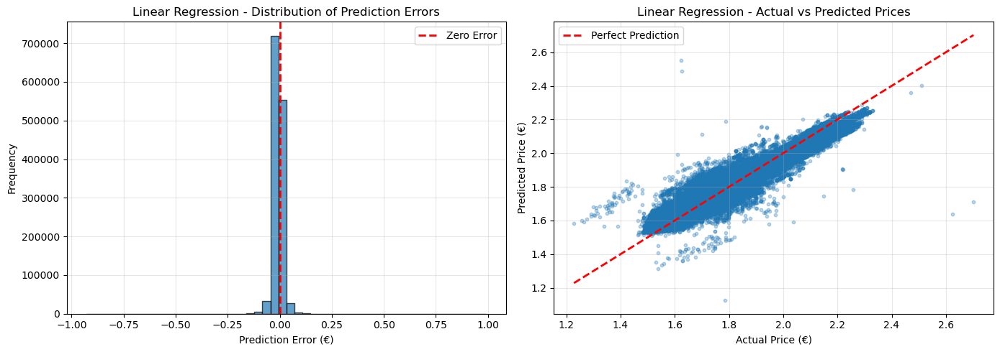

In [26]:
# Convert predictions to pandas for plotting
lr_predictions_pandas = lr_predictions.select("label", "prediction").toPandas()
lr_predictions_pandas['error'] = lr_predictions_pandas['label'] - lr_predictions_pandas['prediction']

# Create side-by-side plots
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# Plot 1: Distribution of prediction errors
axes[0].hist(lr_predictions_pandas['error'], bins=50, edgecolor='black', alpha=0.7)
axes[0].axvline(0, color='red', linestyle='--', linewidth=2, label='Zero Error')
axes[0].set_xlabel('Prediction Error (€)')
axes[0].set_ylabel('Frequency')
axes[0].set_title('Linear Regression - Distribution of Prediction Errors')
axes[0].legend()
axes[0].grid(alpha=0.3)

# Plot 2: Actual vs Predicted scatter plot
axes[1].scatter(lr_predictions_pandas['label'], lr_predictions_pandas['prediction'], alpha=0.3, s=10)
axes[1].plot([lr_predictions_pandas['label'].min(), lr_predictions_pandas['label'].max()], 
             [lr_predictions_pandas['label'].min(), lr_predictions_pandas['label'].max()], 
             'r--', linewidth=2, label='Perfect Prediction')
axes[1].set_xlabel('Actual Price (€)')
axes[1].set_ylabel('Predicted Price (€)')
axes[1].set_title('Linear Regression - Actual vs Predicted Prices')
axes[1].legend()
axes[1].grid(alpha=0.3)

plt.tight_layout()
plt.savefig(f"{config['plot_directory']}/linear_regression_errors.png", dpi=300, bbox_inches='tight')
plt.show()


Above I plot the distribution and scatter plot of prediction errors. The error distribution plot shows that prediction errors are approximately symmetric and centered near zero, with most errors falling within €0.05 of the actual price. The actual vs predicted scatter plot reveals strong alignment along the diagonal, confirming the model's accuracy. We also observe a small bias for the model to underpredict the price when they are higher.


## 4.3 Random Forest

Below I fit my random forest. I encode the categorical variables this time not as one-hot encoding, simply because for random forests this is usually not recommended.

In [27]:
# Prepare data for random forest
rf_modeling_df = df_with_lag.select(
    "prix",
    "week_index",
    "year",
    "nom_carburant",
    "pop",
    "latitude",
    "longitude",
    "dept_code",
    "lag_station_fuel_price",
    "date"
).na.drop()

# Define all the stages for the pipeline
rf_year_indexer = StringIndexer(inputCol="year", outputCol="year_index", handleInvalid="keep")
rf_fuel_indexer = StringIndexer(inputCol="nom_carburant", outputCol="fuel_index", handleInvalid="keep")
rf_pop_indexer = StringIndexer(inputCol="pop", outputCol="pop_index", handleInvalid="keep")
rf_dept_indexer = StringIndexer(inputCol="dept_code", outputCol="dept_index", handleInvalid="keep")

rf_feature_columns = ["week_index", "year_index", "fuel_index", "pop_index", 
                      "latitude", "longitude", "dept_index", "lag_station_fuel_price"]
rf_assembler = VectorAssembler(inputCols=rf_feature_columns, outputCol="features")

rf = RandomForestRegressor(featuresCol="features", labelCol="label", numTrees=50, maxBins=100, maxDepth=5, seed=0)

rf_pipeline_stages = [
    rf_year_indexer, rf_fuel_indexer, rf_pop_indexer, rf_dept_indexer,
    rf_assembler,
    rf
]
rf_pipeline = Pipeline(stages=rf_pipeline_stages)

# Define label column and split data into training and test sets
rf_final_df = rf_modeling_df.withColumn("label", F.col("prix"))

rf_train_df = rf_final_df.filter(F.col("date") < cutoff_date)
rf_test_df = rf_final_df.filter(F.col("date") >= cutoff_date)

print(f"Training set size: {rf_train_df.count():,}")
print(f"Test set size: {rf_test_df.count():,}")

# Fit the pipeline model
rf_pipeline_model = rf_pipeline.fit(rf_train_df)
rf_predictions = rf_pipeline_model.transform(rf_test_df)

# Evaluate the model
rf_evaluator = RegressionEvaluator(labelCol="label", predictionCol="prediction")
rf_rmse = rf_evaluator.setMetricName("rmse").evaluate(rf_predictions)
rf_r2 = rf_evaluator.setMetricName("r2").evaluate(rf_predictions)
rf_mae = rf_evaluator.setMetricName("mae").evaluate(rf_predictions)

print(f"Random Forest Results:")
print(f"RMSE: {rf_rmse:.4f}")
print(f"R-squared: {rf_r2:.4f}")
print(f"MAE: {rf_mae:.4f}")

rf_model = rf_pipeline_model.stages[-1]
print(f"\nNumber of trees: {rf_model.getNumTrees}")
print(f"Total number of features: {len(rf_feature_columns)}")

Training set size: 10,814,822


Test set size: 1,344,351


Random Forest Results:
RMSE: 0.0565
R-squared: 0.7427
MAE: 0.0440

Number of trees: 50
Total number of features: 8


The random forest model achieves an R-squared of 0.7427, RMSE of 0.0565, and MAE of 0.0440. While these metrics are substantially worse than the linear regression model, the random forest still explains approximately 74% of the variance in gas prices.


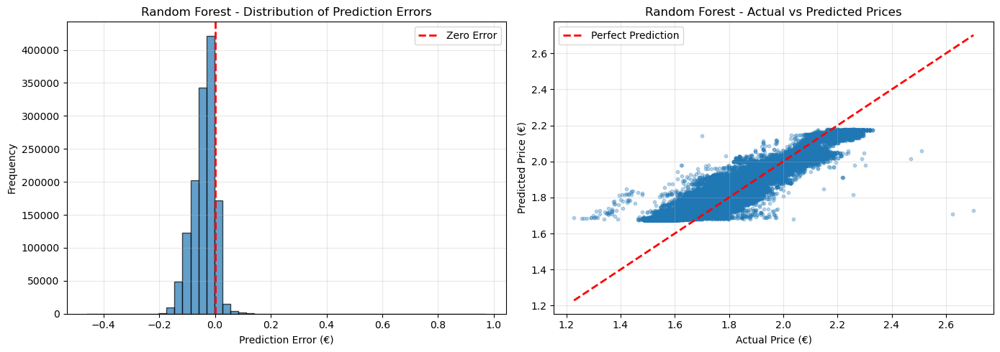

In [28]:
# Convert random forest predictions to pandas for plotting
rf_predictions_pandas = rf_predictions.select("label", "prediction").toPandas()
rf_predictions_pandas['error'] = rf_predictions_pandas['label'] - rf_predictions_pandas['prediction']

# Create side-by-side plots
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# Plot 1: Distribution of prediction errors
axes[0].hist(rf_predictions_pandas['error'], bins=50, edgecolor='black', alpha=0.7)
axes[0].axvline(0, color='red', linestyle='--', linewidth=2, label='Zero Error')
axes[0].set_xlabel('Prediction Error (€)')
axes[0].set_ylabel('Frequency')
axes[0].set_title('Random Forest - Distribution of Prediction Errors')
axes[0].legend()
axes[0].grid(alpha=0.3)

# Plot 2: Actual vs Predicted scatter plot
axes[1].scatter(rf_predictions_pandas['label'], rf_predictions_pandas['prediction'], alpha=0.3, s=10)
axes[1].plot([rf_predictions_pandas['label'].min(), rf_predictions_pandas['label'].max()], 
             [rf_predictions_pandas['label'].min(), rf_predictions_pandas['label'].max()], 
             'r--', linewidth=2, label='Perfect Prediction')
axes[1].set_xlabel('Actual Price (€)')
axes[1].set_ylabel('Predicted Price (€)')
axes[1].set_title('Random Forest - Actual vs Predicted Prices')
axes[1].legend()
axes[1].grid(alpha=0.3)

plt.tight_layout()
plt.savefig(f"{config['plot_directory']}/random_forest_errors.png", dpi=300, bbox_inches='tight')
plt.show()

The random forest error distribution is a little asymmetric and centered close to zero, with most errors concentrated in a narrow range. The actual vs predicted scatter plot shows tight clustering along the diagonal, indicating good model calibration. 


### 4.4 Comparison predictions linear regression and random forest

As a quick extra analysis I look at the average predictions of both models over time in the test set for the different gas types.


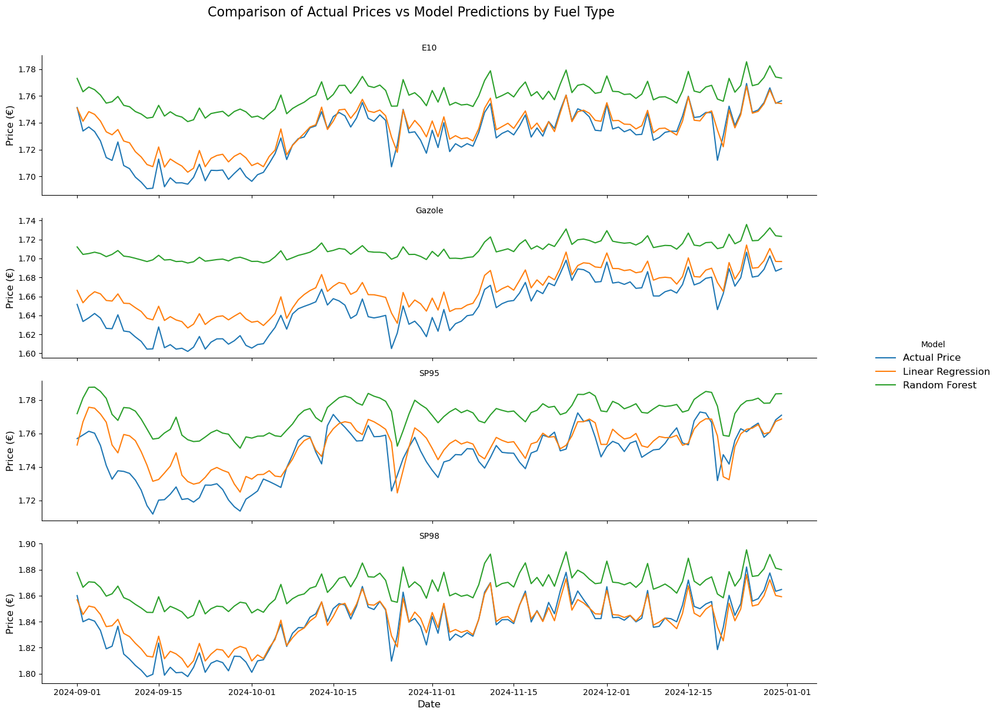

In [24]:
# Combine predictions from both models with actual prices
lr_pred_df = lr_predictions.select("label", "prediction", "date", "nom_carburant").toPandas()
lr_pred_df.rename(columns={'prediction': 'lr_prediction'}, inplace=True)

rf_pred_df = rf_predictions.select("prediction").toPandas()
rf_pred_df.rename(columns={'prediction': 'rf_prediction'}, inplace=True)

# Combine into one dataframe
combined_df = lr_pred_df.copy()
combined_df['rf_prediction'] = rf_pred_df['rf_prediction']

# Group by date and fuel type to get daily averages
combined_agg = combined_df.groupby(['date', 'nom_carburant']).agg({
    'label': 'mean',
    'lr_prediction': 'mean',
    'rf_prediction': 'mean'
}).reset_index()

# Reshape for plotting
combined_long = combined_agg.melt(
    id_vars=['date', 'nom_carburant'], 
    value_vars=['label', 'lr_prediction', 'rf_prediction'],
    var_name='model', 
    value_name='price'
)

# Rename for better legend labels
combined_long['model'] = combined_long['model'].replace({
    'label': 'Actual Price',
    'lr_prediction': 'Linear Regression',
    'rf_prediction': 'Random Forest'
})

# Create FacetGrid with one row per fuel type
facet_grid = sns.FacetGrid(
    combined_long, 
    row='nom_carburant', 
    hue='model',
    height=3, 
    aspect=4,
    sharey=False,
    legend_out=True
)

# Plot lines
facet_grid.map(plt.plot, 'date', 'price', linewidth=1.5)

# Customize labels and title
facet_grid.set_titles(row_template="{row_name}", fontsize=14)
facet_grid.set_axis_labels("Date", "Price (€)", fontsize=12)
facet_grid.add_legend(title='Model', bbox_to_anchor=(1.05, 0.5), loc='center left', fontsize=12)
facet_grid.figure.suptitle('Comparison of Actual Prices vs Model Predictions by Fuel Type', y=1.01, fontsize=16)

plt.tight_layout()
plt.savefig(f"{config['plot_directory']}/model_comparison_facetgrid.png", dpi=300, bbox_inches='tight')
plt.show()

The comparison plot across fuel types reveals that both models track actual prices closely throughout the test period. Key observations:

- Random forest model overestimates the price on average.
- Predictions follow the temporal trends in actual prices, including any volatility or directional changes
- The models perform consistently well across all four fuel types (Gazole, SP95, SP98, E10)
- There are no major divergences between predicted and actual prices during the test period

The strong alignment between actual and predicted prices across time demonstrates that both models have learned robust patterns that generalize well to unseen data.